# Mouse Coordinate Localization

This notebook haws the purpose of experimenting with different image processing techinques that would allow us to automatically detect a mouse in a video, locate its center position and crop the image. 

In [1]:
import os
import pandas as pd
import numpy as np
import cv2
import matplotlib.pyplot as plt

In [2]:
expansion = 80

## Load data and visualize it

In [3]:
# Set the source folders
#videos_src_folder = '../data/raw/videos'
videos_src_folder = '../data/raw/NewVideos/'
#csvs_src_folder = '../data/raw/csvs'

videos = sorted(os.listdir(videos_src_folder))[1:]
#csvs = sorted(os.listdir(csvs_src_folder), key=lambda x: x.split('.')[0][-4:])[1:]

In [4]:
videos[0]

'1.mp4'

In [113]:
#midbodies_target = []
video_frames = []

#for csv, video in zip(csvs[:1], videos[:1]):
for video in videos[1:2]:
    # Get video frames
    vidcap = cv2.VideoCapture(os.path.join(videos_src_folder, video))
    success,image = vidcap.read()
    count = 0
    while success:
        
        video_frames.append(image)  
        success, image = vidcap.read()
        count += 1

In [114]:
len(video_frames)

12057

In [ ]:
# We will get some frames to test with them 
frames = np.array(video_frames[:5000])
frames.shape

In [ ]:
plt.imshow(frames[0,:,:])
plt.colorbar()

## Image processing

While finding the best method, we will just use one image.

(480, 640)


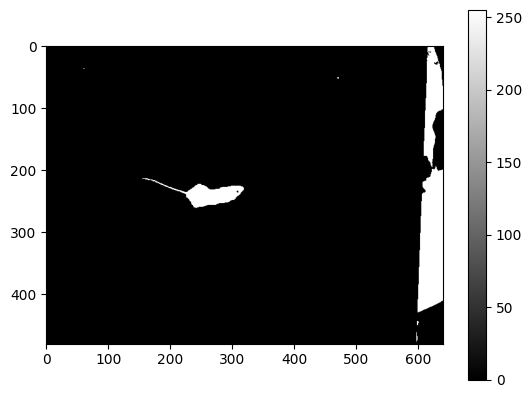

In [58]:
image = frames[0]

# We can start by converting the image to Gray scale
gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
# We can rescale the values to highlight constrasted areas
thresh = cv2.threshold(gray, 0, 255, cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU)[1]

print(thresh.shape)

plt.imshow(thresh[:,:], cmap = 'gray')
plt.colorbar()

As we can see, on the left part of the image we have an unwanted area. We want to only, focus on the box, therefor we can crop the image arround it. After that, we will try to find the center part of the highlighted area(the mouse). 

In [48]:
# We can apply a filter to found the sharp areas, that way the box will be highlighted
thresh2 = np.invert(thresh)
kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (3,3))
close = cv2.morphologyEx(thresh2, cv2.MORPH_CLOSE, kernel, iterations=2)

cnts = cv2.findContours(close, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
cnts = cnts[0] if len(cnts) == 2 else cnts[1]

# We want to void noise, for that we will just consider the biggest countour since it is going to be the box
c = 0
c_len = len(cnts[0])
for i in range(len(cnts[1:])):
    if len(cnts[i]) > c_len:
        c = i
        c_len = len(cnts[i])
        
 
# Obtain bounding rectangle to get the box coordinates
x,y,w,h = cv2.boundingRect(cnts[c])

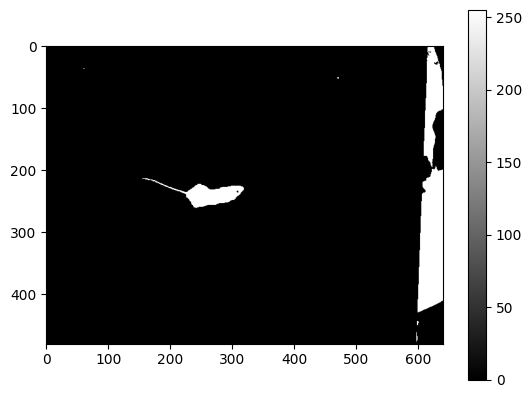

In [53]:
plt.imshow(thresh,cmap='gray')
plt.colorbar()

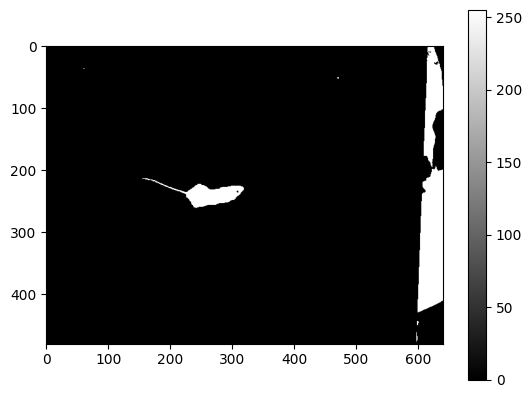

In [50]:
#crop = thresh[y:y+h, x:x+w]
crop = thresh

plt.imshow(crop, cmap = 'gray')
plt.colorbar()

What we can do now is finding the countour of the mouse  and calculate the centroid, this would be the central coordinate.

Coordiantes:  265 239


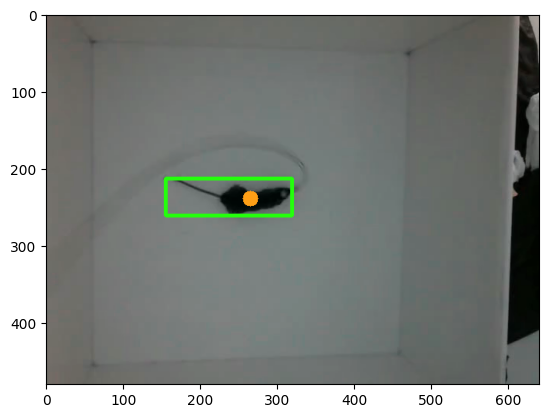

In [51]:
#image2 = image[y:y+h, x:x+w].copy()
image2 = image.copy()
cnts = cv2.findContours(crop, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
cnts = cnts[0] if len(cnts) == 2 else cnts[1]

# We want to void noise, for that we will just consider the biggest countour since it is going to be the mouse
c = 0
c_len = len(cnts[0])
for i in range(len(cnts[1:])):
    if len(cnts[i]) > c_len:
        c = i
        c_len = len(cnts[i])
        
 # Obtain bounding rectangle to get measurements
x,y,w,h = cv2.boundingRect(cnts[c])

# Find centroid
M = cv2.moments(cnts[c])
cX = int(M["m10"] / M["m00"])
cY = int(M["m01"] / M["m00"])

print('Coordiantes: ', cX, cY)

# Crop and save ROI
ROI = image2[y:y+h, x:x+w]

# Draw the contour and center of the shape on the image
cv2.rectangle(image2,(x,y),(x+w,y+h),(36,255,12), 4)
cv2.circle(image2, (cX, cY), 10, (320, 159, 22), -1) 

plt.imshow(image2)

As we can see, we have been able of obtaiing an aproximate location of the central part of the mouse. We can now apply this technique to all frames.

## Get all frames central position 

In [105]:
position = [0,0]
def get_coordinates(image):
    
    # We can start by converting the image to Gray scale
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    # We can rescale the values to highlight constrasted areas
    thresh = cv2.threshold(gray, 0, 255, cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU)[1]
    
    # We can crop the box
    thresh2 = np.invert(thresh)
    kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (3,3))
    close = cv2.morphologyEx(thresh2, cv2.MORPH_CLOSE, kernel, iterations=2)
    
    cnts = cv2.findContours(close, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    cnts = cnts[0] if len(cnts) == 2 else cnts[1]
    
    # We want to avoid noise, for that we will just consider the biggest countour since it is going to be the box
    c = 0
    c_len = len(cnts[0])
    for i in range(len(cnts[1:])):
        if len(cnts[i]) > c_len:
            c = i
            c_len = len(cnts[i])            
    
    # Obtain bounding rectangle to get the box coordinates
    x,y,w,h = cv2.boundingRect(cnts[c])

    # If the box is way to big, we won't need to crop it, else we will 
    if (x+w - x) < image.shape[0]//4:
        image2 = image.copy()
        crop = thresh.copy()
    else:
        # Find bounding box and centroid
        image2 = image[y:y+h, x:x+w].copy()
        crop = thresh[y:y+h, x:x+w]

    # We can now look for the mouse contour
    cnts = cv2.findContours(crop, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    cnts = cnts[0] if len(cnts) == 2 else cnts[1]
   
    # We want to avoid noise, for that we will just consider the biggest countour since it is going to be the mouse as long as it is not
    # to close to the extremes of the iamge, since that would mean it is an external object
    c = 0
    c_len = len(cnts[0])
    for i in range(len(cnts[1:])):
        if len(cnts[i]) > c_len:
            # Obtain bounding rectangle to get measurements
            x,y,w,h = cv2.boundingRect(cnts[i])
            if not (y < 100) or not (y+h > image.shape[0]-100):
                c = i
                c_len = len(cnts[i])

    x,y,w,h = cv2.boundingRect(cnts[c])
    
    # Find centroid
    M = cv2.moments(cnts[c])            
    cX = int(M["m10"] / (M["m00"] + 1e-10))
    cY = int(M["m01"] / (M["m00"]+ 1e-10))
    # Crop and save ROI
    ROI = image2[y:y+h, x:x+w]
    # Draw the contour and center of the shape on the image
    cv2.rectangle(image2,(x,y),(x+w,y+h),(36,255,12), 4)
    cv2.circle(image2, (cX, cY), 10, (320, 159, 22), -1) 

    return (cX,cY), image2

def get_midbody(frames):
    mid_body=[]
    video=[]
    for frame in frames:
        coordinate, image = get_coordinates(frame)
        mid_body.append(coordinate)
        video.append(image)
    return mid_body,video    

In [108]:
coordinates, video = get_midbody(frames[15:50])

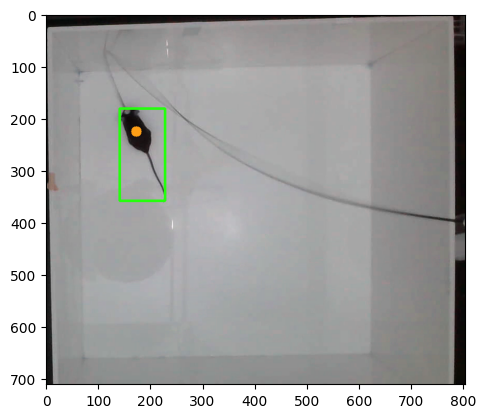

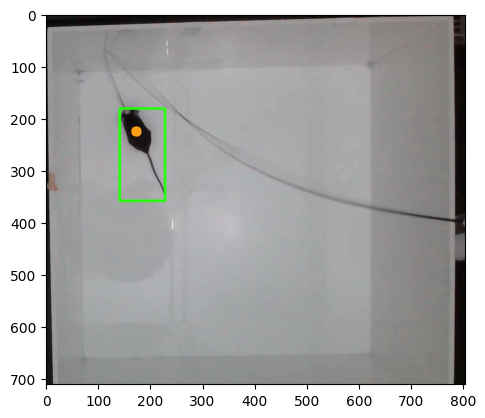

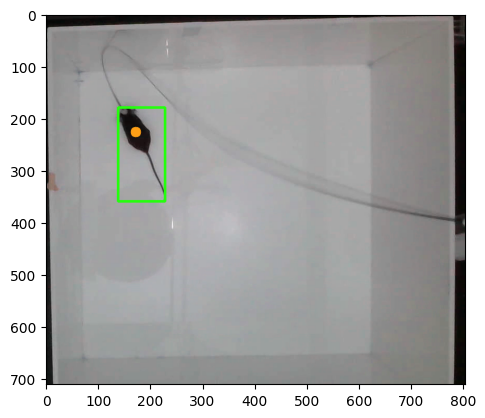

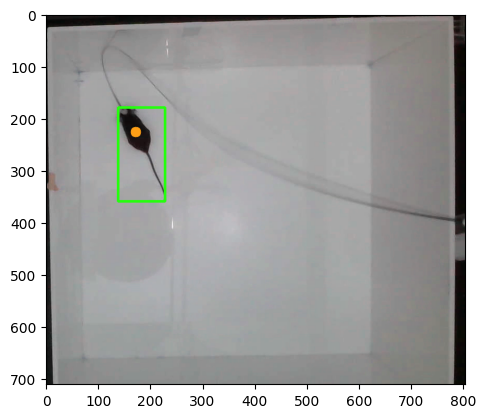

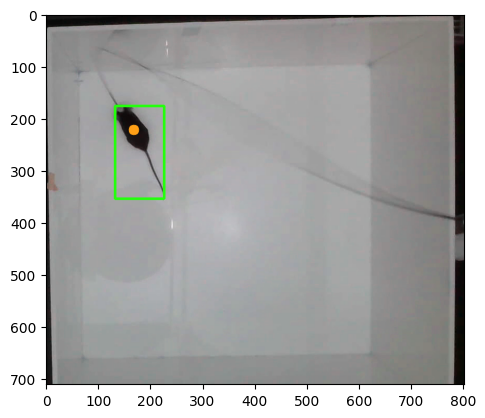

...

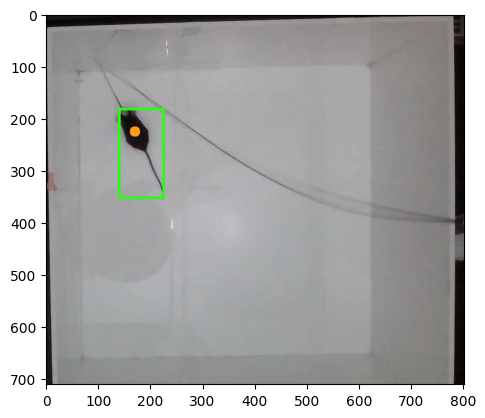

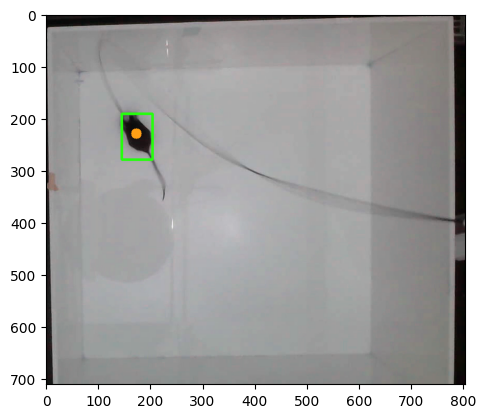

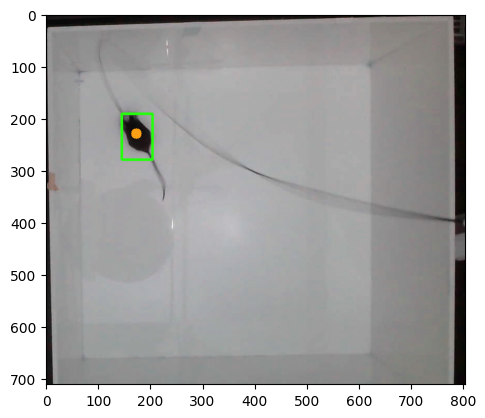

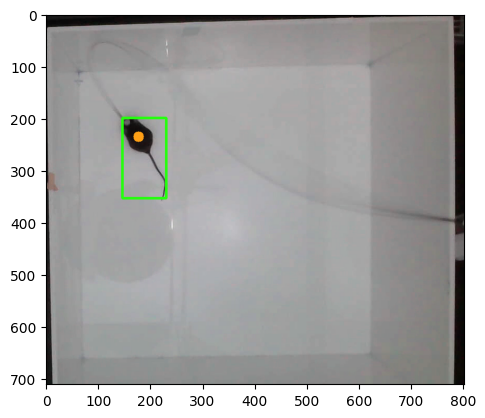

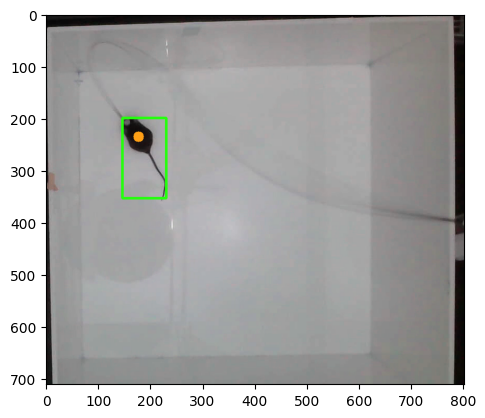

In [109]:
for img in video[15:]:
    plt.imshow(img)
    plt.show()

## Evaluate performance

We can try with a different batch of frames

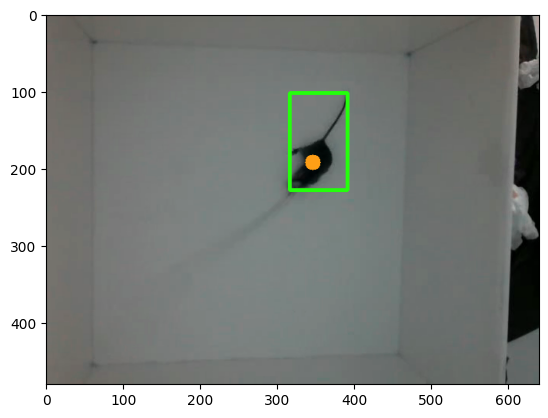

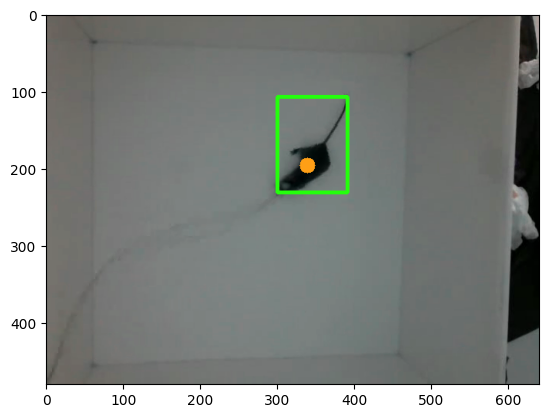

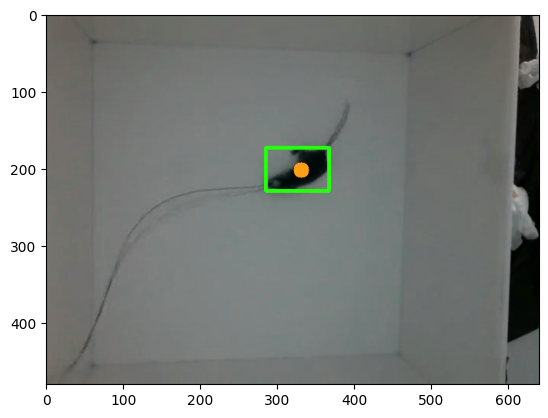

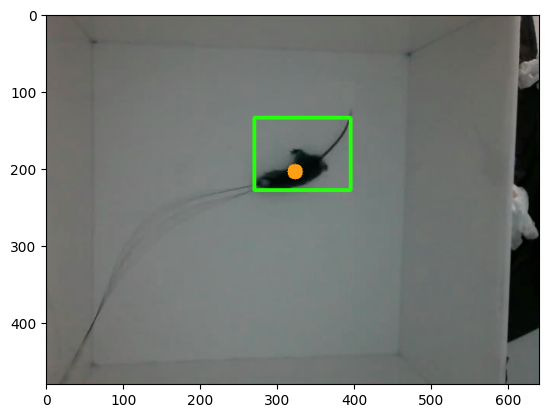

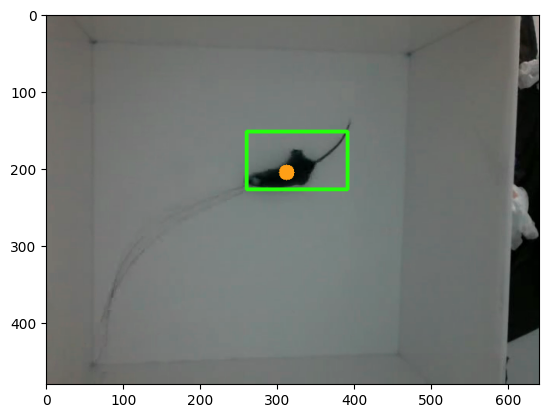

...

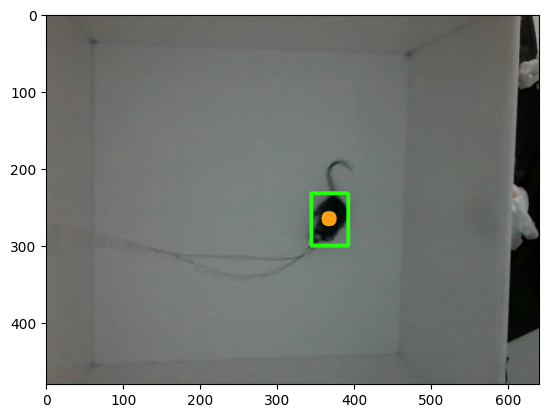

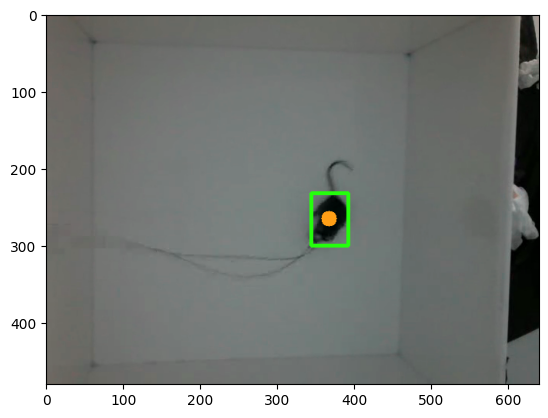

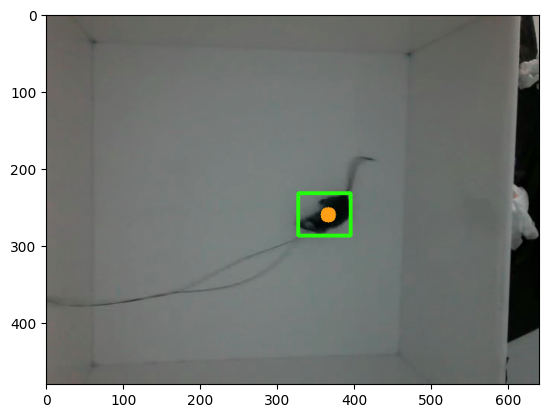

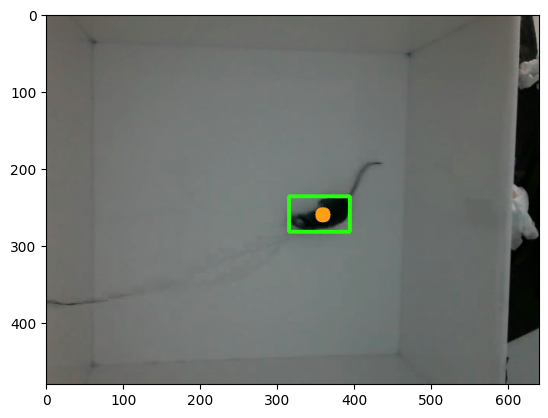

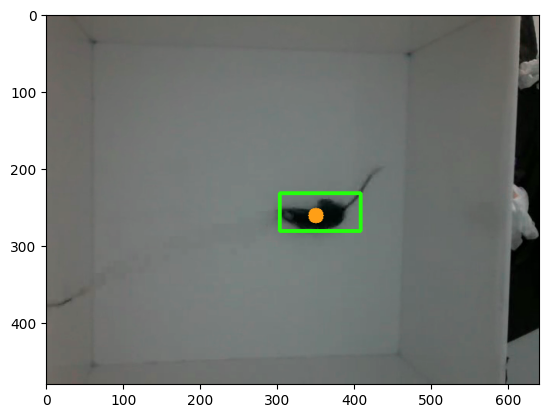

In [106]:
videos_src_folder = '../data/raw/videos'
videos = sorted(os.listdir(videos_src_folder))[1:]

video_frames = []

#for csv, video in zip(csvs[:1], videos[:1]):
for video in videos[1:2]:
    # Get video frames
    vidcap = cv2.VideoCapture(os.path.join(videos_src_folder, video))
    success,image = vidcap.read()
    count = 0
    while success and count < 150:
        video_frames.append(image)  
        success, image = vidcap.read()
        count += 1

frames = np.array(video_frames)
coordinates, video = get_midbody(frames)

for img in video[15:]:
    plt.imshow(img)
    plt.show()

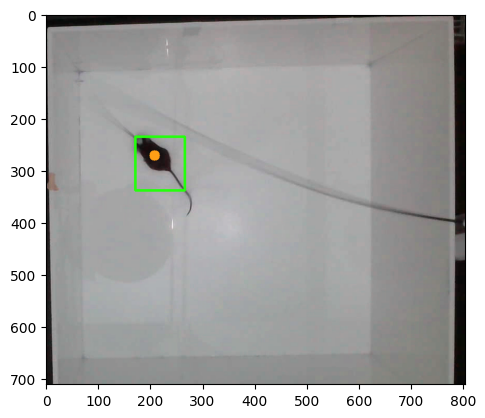

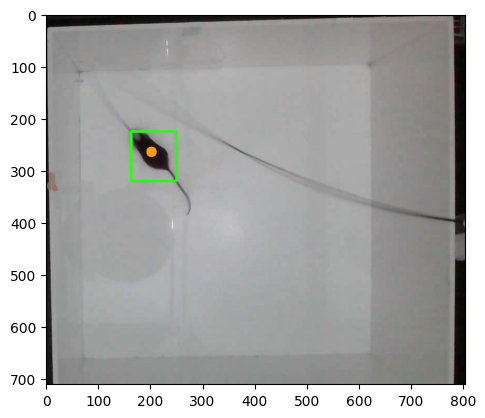

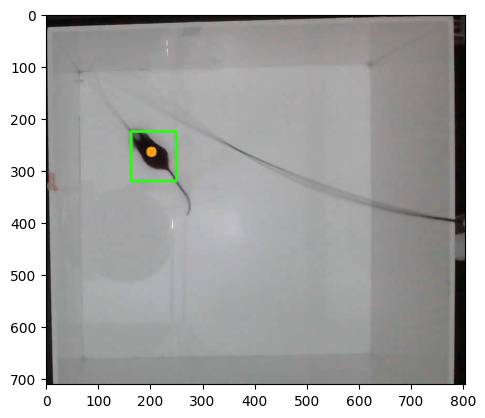

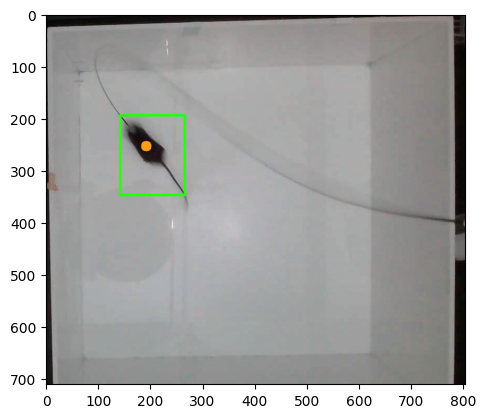

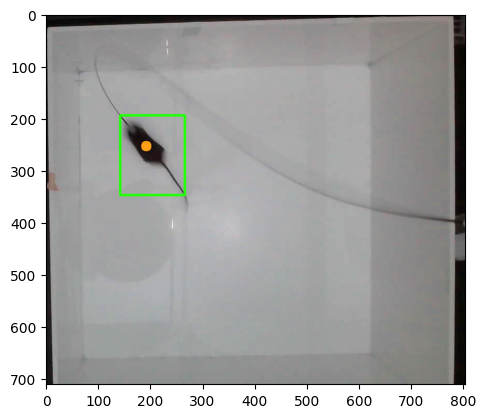

...

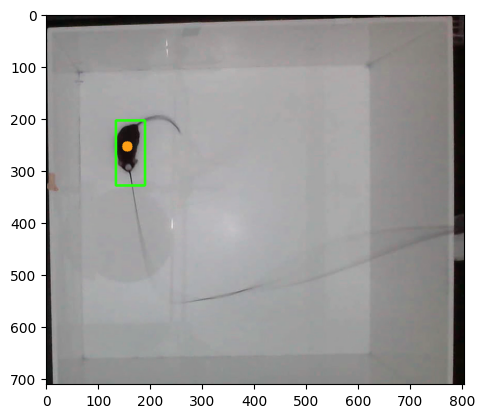

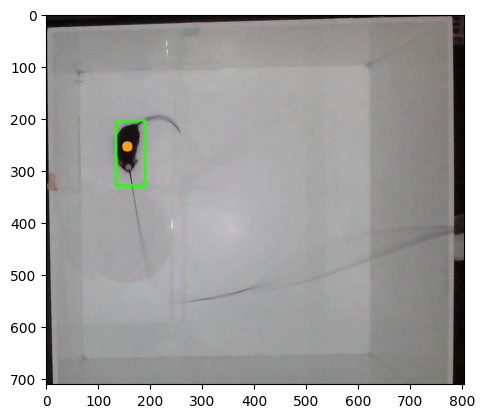

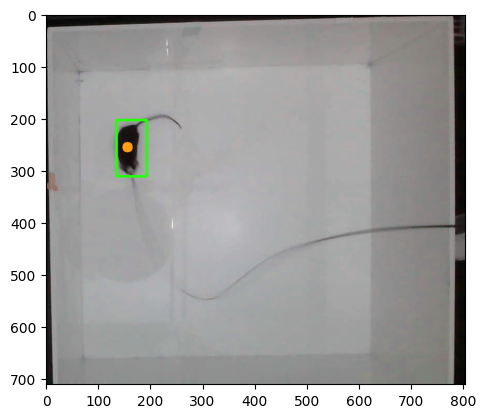

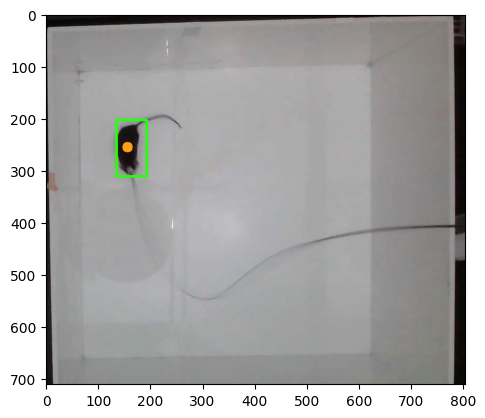

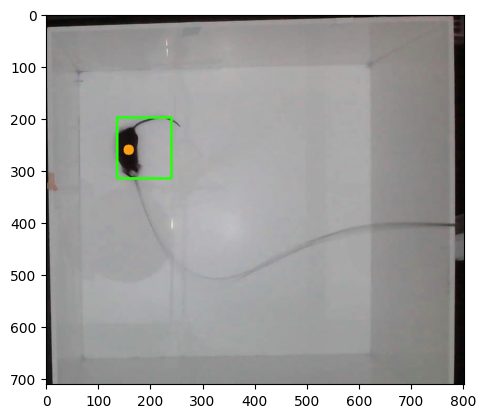

In [107]:
videos_src_folder = '../data/raw/NewVideos'
videos = sorted(os.listdir(videos_src_folder))[1:]

video_frames = []

#for csv, video in zip(csvs[:1], videos[:1]):
for video in videos[:1]:
    # Get video frames
    vidcap = cv2.VideoCapture(os.path.join(videos_src_folder, video))
    success,image = vidcap.read()
    count = 0
    while success and count < 150:
        video_frames.append(image)  
        success, image = vidcap.read()
        count += 1

frames = np.array(video_frames)
coordinates, video = get_midbody(frames)

for img in video[15:]:
    plt.imshow(img)
    plt.show()

## Generate csv without mid_body

In [30]:
df = pd.read_csv(os.path.join(csvs_src_folder, csvs[0]), header=0)
print(df.columns)
df = df.drop([ 'midbody x'],axis=1)
print(df.columns)
df.to_csv('HD_ChR2_480A_v2')

Index(['frame_seq', 'Genotip', 'Tractament', 'Estimulació', 'Grooming',
       'Rearing mig', 'Rearing paret', 'snout x', 'snout y',
       'snout likelihood', 'crown x', 'crown y', 'crown likelihood', 'Lear x',
       'Lear y', 'Lear likelihood', 'Rear x', 'Rear y', 'Rear likelihood',
       'midbody x', 'midbody y', 'midbody likelihood', 'tailbase x',
       'tailbase y', 'tailbase likelihood', 'tailtip x', 'tailtip y',
       'tailtip likelihood', 'FrontL x', 'FrontL y', 'FrontL likelihood',
       'FrontR x', 'FrontR y', 'FrontR likelihood', 'BackL x', 'BackL y',
       'BackL likelihood', 'BackR x', 'BackR y', 'BackR likelihood',
       'Nsnout x', 'Nsnout y', 'NBsnout x', 'NBsnout y', 'Ncrown x',
       'Ncrown y', 'NBcrown x', 'NBcrown y', 'NLear x', 'NLear y', 'NBLear x',
       'NBLear y', 'NRear x', 'NRear y', 'NBRear x', 'NBRear y', 'Ntailbase x',
       'Ntailbase y', 'NBtailbase x', 'NBtailbase y', 'Ntailtip x',
       'Ntailtip y', 'NBtailtip x', 'NBtailtip y', 'NFrontL x